# LOGISTIC REGRESSION

## Import Libraries

In [156]:
import numpy as np
import pandas as pd

#Visualization libraries
import matplotlib.pyplot as plt               # for simple graphs
import seaborn as sns                         # complex visualization

from sklearn.datasets import load_breast_cancer          # for loading dataset
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split,GridSearchCV,RandomizedSearchCV      # split training and testing data
from sklearn.linear_model import LogisticRegression, Ridge
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report,roc_curve

from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.ensemble import RandomForestClassifier                   # for Random Forest Algorithm

from sklearn.ensemble import AdaBoostClassifier,AdaBoostRegressor     # for Adaboost Algorithm

from sklearn.tree import DecisionTreeClassifier,plot_tree             # for Decision Tree Algorithm

from sklearn.svm import SVC                                           # for SVM Algorithm

import warnings                                                       # for removing warnings
warnings.filterwarnings("ignore")

## 1. Problem Statement

## 2. Data Gathering

In [2]:
cancer = load_breast_cancer()
df = pd.DataFrame(cancer.data, columns = cancer.feature_names)
df

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [3]:
df["Prediction"] = cancer.target
df

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,Prediction
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890,0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,0
565,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,0
566,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,0
567,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,0


## 3. EDA (Exploratory Data Analysis)

In [4]:
df.shape

(569, 31)

In [5]:
df.columns

Index(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error', 'fractal dimension error',
       'worst radius', 'worst texture', 'worst perimeter', 'worst area',
       'worst smoothness', 'worst compactness', 'worst concavity',
       'worst concave points', 'worst symmetry', 'worst fractal dimension',
       'Prediction'],
      dtype='object')

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   mean radius              569 non-null    float64
 1   mean texture             569 non-null    float64
 2   mean perimeter           569 non-null    float64
 3   mean area                569 non-null    float64
 4   mean smoothness          569 non-null    float64
 5   mean compactness         569 non-null    float64
 6   mean concavity           569 non-null    float64
 7   mean concave points      569 non-null    float64
 8   mean symmetry            569 non-null    float64
 9   mean fractal dimension   569 non-null    float64
 10  radius error             569 non-null    float64
 11  texture error            569 non-null    float64
 12  perimeter error          569 non-null    float64
 13  area error               569 non-null    float64
 14  smoothness error         5

In [7]:
df.describe()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,Prediction
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,0.627417
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,0.483918
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,0.000000
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,0.000000
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,1.000000
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,1.000000
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,1.000000


<Axes: xlabel='worst fractal dimension', ylabel='Density'>

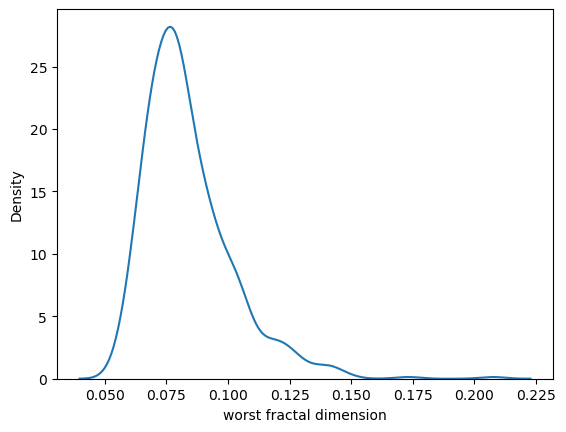

In [8]:
sns.kdeplot(df["worst fractal dimension"])

<Axes: xlabel='mean smoothness', ylabel='Density'>

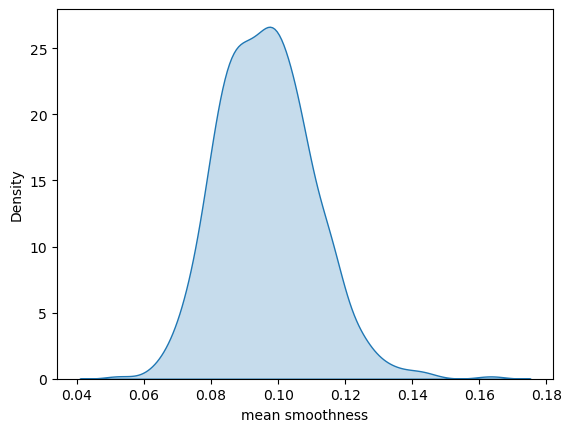

In [9]:
sns.kdeplot(df["mean smoothness"], fill = True)

<Axes: >

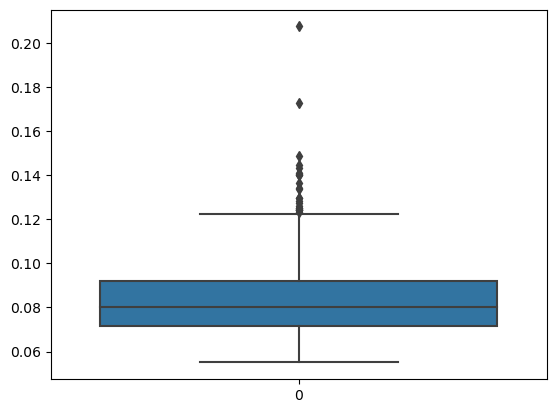

In [10]:
sns.boxplot(df["worst fractal dimension"])

<Axes: >

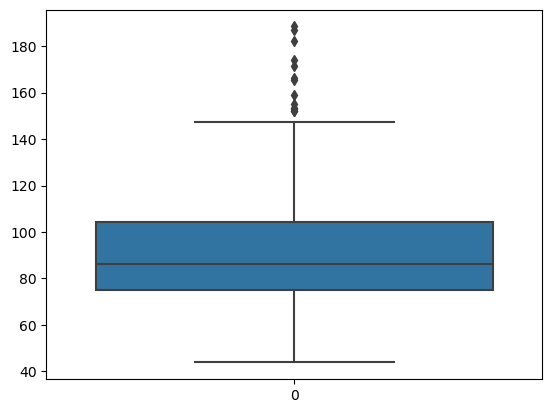

In [11]:
sns.boxplot(df["mean perimeter"])

<Axes: >

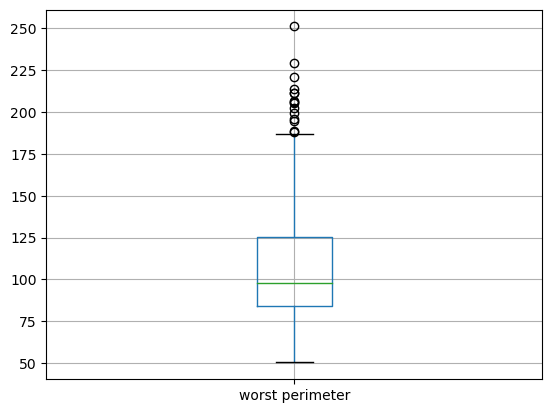

In [12]:
df[["worst perimeter"]].boxplot()

In [13]:
q1 = df["worst perimeter"].quantile(0.25)
q2 = df["worst perimeter"].quantile(0.50)
q3 = df["worst perimeter"].quantile(0.75)

iqr = q3-q1

upper_tail = q3 + 1.5*iqr
lower_tail = q1 - 1.5*iqr

In [14]:
upper_tail

187.335

In [15]:
lower_tail

22.17499999999999

## 4. Feature Engineering

In [16]:
std = StandardScaler()
std_array = std.fit_transform(df.iloc[:,:30])
df1 = pd.DataFrame(std_array,columns = df.iloc[:,:30].columns)
df1.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,1.097064,-2.073335,1.269934,0.984375,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747,...,1.886690,-1.359293,2.303601,2.001237,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015
1,1.829821,-0.353632,1.685955,1.908708,-0.826962,-0.487072,-0.023846,0.548144,0.001392,-0.868652,...,1.805927,-0.369203,1.535126,1.890489,-0.375612,-0.430444,-0.146749,1.087084,-0.243890,0.281190
2,1.579888,0.456187,1.566503,1.558884,0.942210,1.052926,1.363478,2.037231,0.939685,-0.398008,...,1.511870,-0.023974,1.347475,1.456285,0.527407,1.082932,0.854974,1.955000,1.152255,0.201391
3,-0.768909,0.253732,-0.592687,-0.764464,3.283553,3.402909,1.915897,1.451707,2.867383,4.910919,...,-0.281464,0.133984,-0.249939,-0.550021,3.394275,3.893397,1.989588,2.175786,6.046041,4.935010
4,1.750297,-1.151816,1.776573,1.826229,0.280372,0.539340,1.371011,1.428493,-0.009560,-0.562450,...,1.298575,-1.466770,1.338539,1.220724,0.220556,-0.313395,0.613179,0.729259,-0.868353,-0.397100


In [17]:
vif_df = pd.DataFrame()
vif_df["Features"] = df1.columns
vif_df

,Features
0,mean radius
1,mean texture
2,mean perimeter
3,mean area
4,mean smoothness
5,mean compactness
6,mean concavity
7,mean concave points
8,mean symmetry
9,mean fractal dimension


In [18]:
vif_list = []

for i in range(df1.shape[1]):
    vif = variance_inflation_factor(df1.to_numpy(),i)
    vif_list.append(vif)
    
vif_df["VIF"] = vif_list
vif_df

,Features,VIF
0,mean radius,3806.115296
1,mean texture,11.884048
2,mean perimeter,3786.400419
3,mean area,347.878657
4,mean smoothness,8.194282
5,mean compactness,50.505168
6,mean concavity,70.767720
7,mean concave points,60.041733
8,mean symmetry,4.220656
9,mean fractal dimension,15.756977


In [19]:
df1.drop(["mean radius","mean perimeter","mean area","worst radius","worst perimeter","worst area"], axis=1, inplace=True)

In [20]:
df1.head()

,mean texture,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,...,concave points error,symmetry error,fractal dimension error,worst texture,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,-2.073335,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747,2.489734,-0.565265,2.833031,...,0.660820,1.148757,0.907083,-1.359293,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015
1,-0.353632,-0.826962,-0.487072,-0.023846,0.548144,0.001392,-0.868652,0.499255,-0.876244,0.263327,...,0.260162,-0.805450,-0.099444,-0.369203,-0.375612,-0.430444,-0.146749,1.087084,-0.243890,0.281190
2,0.456187,0.942210,1.052926,1.363478,2.037231,0.939685,-0.398008,1.228676,-0.780083,0.850928,...,1.424827,0.237036,0.293559,-0.023974,0.527407,1.082932,0.854974,1.955000,1.152255,0.201391
3,0.253732,3.283553,3.402909,1.915897,1.451707,2.867383,4.910919,0.326373,-0.110409,0.286593,...,1.115007,4.732680,2.047511,0.133984,3.394275,3.893397,1.989588,2.175786,6.046041,4.935010
4,-1.151816,0.280372,0.539340,1.371011,1.428493,-0.009560,-0.562450,1.270543,-0.790244,1.273189,...,1.144205,-0.361092,0.499328,-1.466770,0.220556,-0.313395,0.613179,0.729259,-0.868353,-0.397100


In [21]:
df1.shape

(569, 24)

In [22]:
df1["Prediction"] = df["Prediction"]
df1.shape

(569, 25)

## 5. Feature Selection

In [23]:
df1.corr()

,mean texture,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,...,symmetry error,fractal dimension error,worst texture,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,Prediction
mean texture,1.000000,-0.023389,0.236702,0.302418,0.293464,0.071401,-0.076437,0.275869,0.386358,0.281673,...,0.009127,0.054458,0.912045,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205,-0.415185
mean smoothness,-0.023389,1.000000,0.659123,0.521984,0.553695,0.557775,0.584792,0.301467,0.068406,0.296092,...,0.200774,0.283607,0.036072,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316,-0.358560
mean compactness,0.236702,0.659123,1.000000,0.883121,0.831135,0.602641,0.565369,0.497473,0.046205,0.548905,...,0.229977,0.507318,0.248133,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382,-0.596534
mean concavity,0.302418,0.521984,0.883121,1.000000,0.921391,0.500667,0.336783,0.631925,0.076218,0.660391,...,0.178009,0.449301,0.299879,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930,-0.696360
mean concave points,0.293464,0.553695,0.831135,0.921391,1.000000,0.462497,0.166917,0.698050,0.021480,0.710650,...,0.095351,0.257584,0.292752,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661,-0.776614
mean symmetry,0.071401,0.557775,0.602641,0.500667,0.462497,1.000000,0.479921,0.303379,0.128053,0.313893,...,0.449137,0.331786,0.090651,0.426675,0.473200,0.433721,0.430297,0.699826,0.438413,-0.330499
mean fractal dimension,-0.076437,0.584792,0.565369,0.336783,0.166917,0.479921,1.000000,0.000111,0.164174,0.039830,...,0.345007,0.688132,-0.051269,0.504942,0.458798,0.346234,0.175325,0.334019,0.767297,0.012838
radius error,0.275869,0.301467,0.497473,0.631925,0.698050,0.303379,0.000111,1.000000,0.213247,0.972794,...,0.240567,0.227754,0.194799,0.141919,0.287103,0.380585,0.531062,0.094543,0.049559,-0.567134
texture error,0.386358,0.068406,0.046205,0.076218,0.021480,0.128053,0.164174,0.213247,1.000000,0.223171,...,0.411621,0.279723,0.409003,-0.073658,-0.092439,-0.068956,-0.119638,-0.128215,-0.045655,0.008303
perimeter error,0.281673,0.296092,0.548905,0.660391,0.710650,0.313893,0.039830,0.972794,0.223171,1.000000,...,0.266487,0.244143,0.200371,0.130054,0.341919,0.418899,0.554897,0.109930,0.085433,-0.556141


<Axes: >

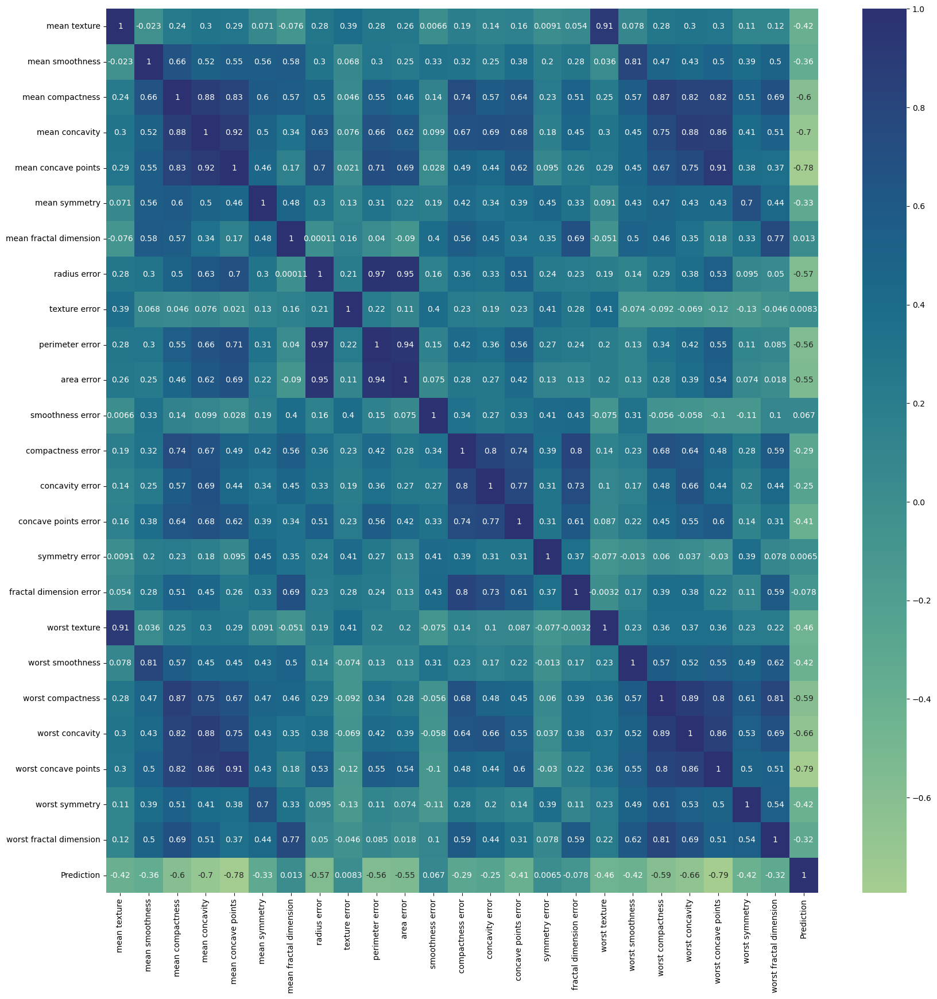

In [24]:
plt.figure(figsize = (20,20))
sns.heatmap(df1.corr(), annot = True, cmap = "crest")

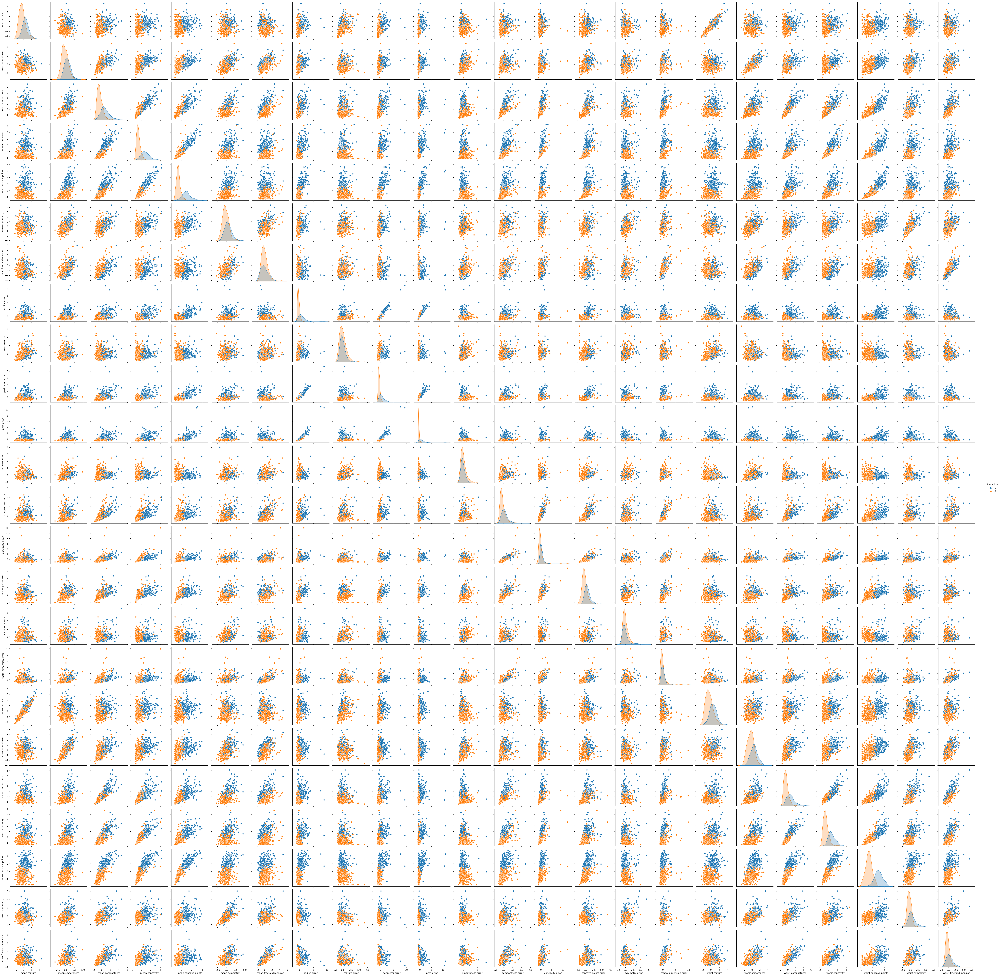

In [27]:
sns.pairplot(df1, hue = "Prediction")

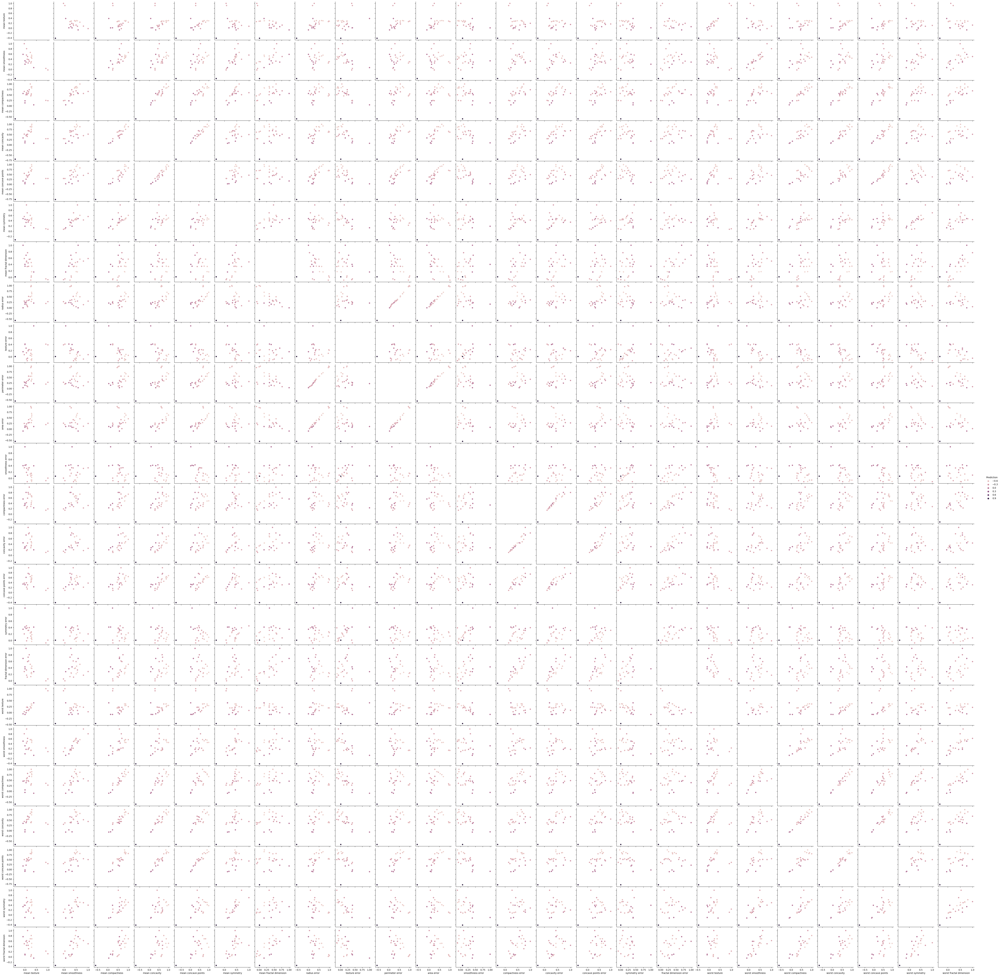

In [24]:
sns.pairplot(df1.corr(),hue = "Prediction")

In [25]:
x = df1.iloc[:,:24]
y = df1["Prediction"]

In [26]:
df1["Prediction"].value_counts()

1    357
0    212
Name: Prediction, dtype: int64

<Axes: xlabel='Prediction', ylabel='count'>

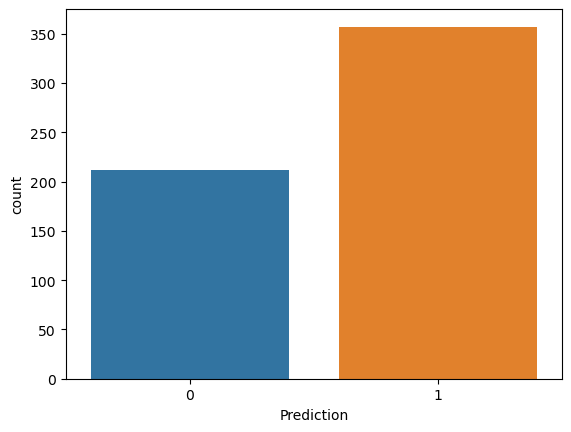

In [27]:
sns.countplot(x = df1["Prediction"])

### train test split

In [28]:
xtrain, xtest, ytrain, ytest = train_test_split(x,y, test_size = 0.2,random_state=10, stratify = y) #test_size : dividing data into 80-20, randomsamples : random selection of data, stratify : divide data into equal proporation

In [29]:
xtrain.head()

,mean texture,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,...,concave points error,symmetry error,fractal dimension error,worst texture,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
149,-0.321053,-1.204139,-0.769070,-0.753164,-0.919018,-1.236277,-0.991984,-0.560049,-0.833607,-0.640104,...,-0.968090,-0.878097,-0.688003,-0.523905,-1.545592,-0.457162,-0.555498,-0.828574,-0.891002,-0.765061
130,-1.396158,0.728714,-0.175320,-0.756428,-0.518437,0.249657,0.271101,-0.738704,-0.726742,-0.442092,...,-0.600522,0.735879,0.131668,-1.281128,0.452886,0.026940,-0.830156,-0.498461,0.919295,0.469050
88,0.584176,-0.614889,-0.187449,-0.359691,-0.295835,0.432204,0.176122,-0.387528,0.517354,-0.328235,...,0.183924,-0.116514,0.252708,0.785359,-0.086295,-0.050669,-0.138113,0.089742,0.115258,0.480133
131,0.044296,0.913744,0.340350,0.725686,0.824140,0.435855,-0.685782,0.249497,-0.781898,0.112838,...,-0.140496,-0.795764,-0.504551,0.052562,0.974533,-0.094562,0.512911,0.560244,-0.103143,-0.208132
254,0.009390,0.508101,0.274020,0.616458,0.954141,-0.130042,-0.897005,0.688377,-1.057134,0.460844,...,0.141749,-0.834509,-0.470887,-0.180304,0.759738,0.393357,0.765260,1.298734,0.773694,0.307790


## 6. Model Training

In [30]:
log_reg = LogisticRegression()
log_reg

LogisticRegression()

In [31]:
log_reg_model = log_reg.fit(xtrain,ytrain)
log_reg_model

LogisticRegression()

In [32]:
y_pred_train = log_reg_model.predict(xtrain)
y_pred_train

array([1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0,
       1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1,
       0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0,
       1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0,
       1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1,
       1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1,
       1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1,
       0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1,

## 7. Model Evaluation

### For training data

Accuracy = 0.9846153846153847
------------------------------------------------------------
Confusion Matrix
 [[164   6]
 [  1 284]]
------------------------------------------------------------
Classification Report
               precision    recall  f1-score   support

           0       0.99      0.96      0.98       170
           1       0.98      1.00      0.99       285

    accuracy                           0.98       455
   macro avg       0.99      0.98      0.98       455
weighted avg       0.98      0.98      0.98       455



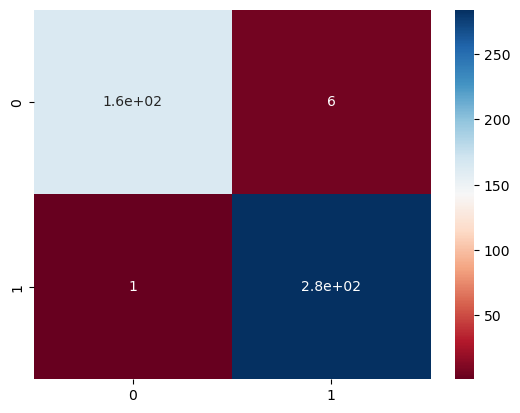

In [33]:
accuracy = accuracy_score(ytrain,y_pred_train)
print(f"Accuracy = {accuracy}")
print("-"*60)

conf_mat = confusion_matrix(ytrain,y_pred_train)
print("Confusion Matrix\n",conf_mat)
sns.heatmap(conf_mat, annot=True, cmap = "RdBu")
print("-"*60)

clf_rep = classification_report(ytrain,y_pred_train)
print("Classification Report\n",clf_rep)

### For testing data

In [34]:
y_pred_test = log_reg_model.predict(xtest)

Accuracy = 0.9649122807017544
------------------------------------------------------------
Confusion Matrix
 [[39  3]
 [ 1 71]]
------------------------------------------------------------
Classification Report
               precision    recall  f1-score   support

           0       0.97      0.93      0.95        42
           1       0.96      0.99      0.97        72

    accuracy                           0.96       114
   macro avg       0.97      0.96      0.96       114
weighted avg       0.97      0.96      0.96       114



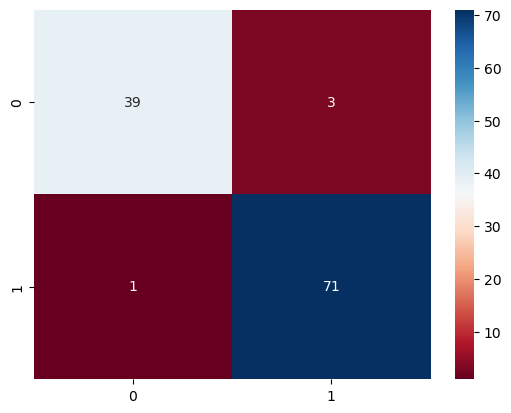

In [35]:
accuracy = accuracy_score(ytest,y_pred_test)
print(f"Accuracy = {accuracy}")
print("-"*60)

conf_mat = confusion_matrix(ytest,y_pred_test)
print("Confusion Matrix\n",conf_mat)
sns.heatmap(conf_mat, annot=True, cmap = "RdBu")
print("-"*60)

clf_rep = classification_report(ytest,y_pred_test)
print("Classification Report\n",clf_rep)

## Ridge Regression

In [36]:
ridge_reg = Ridge()
ridge_reg

Ridge()

In [37]:
ridge_reg_model = ridge_reg.fit(xtrain,ytrain)
ridge_reg_model

Ridge()

In [38]:
y_pred_train = ridge_reg_model.predict(xtrain)
y_pred_train.shape

(455,)

In [39]:
y_pred_test = ridge_reg_model.predict(xtest)
y_pred_test.shape

(114,)

## Lasso Regression

In [40]:
from sklearn.linear_model import Lasso

In [41]:
lasso = Lasso(alpha=1.0)
lasso

Lasso()

In [42]:
lasso_model = lasso.fit(xtrain,ytrain)
lasso_model

Lasso()

In [43]:
y_pred_train = lasso_model.predict(xtrain)
y_pred_train

array([0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637

In [44]:
y_pred_test = lasso_model.predict(xtest)
y_pred_test

array([0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637363,
       0.62637363, 0.62637363, 0.62637363, 0.62637363, 0.62637

## ROC curve

In [45]:
prob = log_reg_model.predict_proba(xtrain)

In [46]:
prob

array([[3.76784973e-03, 9.96232150e-01],
       [1.29176039e-03, 9.98708240e-01],
       [1.08164353e-01, 8.91835647e-01],
       [9.96908779e-01, 3.09122065e-03],
       [9.99932028e-01, 6.79715835e-05],
       [1.29950611e-03, 9.98700494e-01],
       [9.99993074e-01, 6.92628710e-06],
       [9.88279858e-01, 1.17201422e-02],
       [9.99985623e-01, 1.43766911e-05],
       [8.16390415e-01, 1.83609585e-01],
       [9.78168456e-01, 2.18315439e-02],
       [9.99999790e-01, 2.10112976e-07],
       [8.36456942e-05, 9.99916354e-01],
       [4.93437724e-02, 9.50656228e-01],
       [9.98120770e-01, 1.87923032e-03],
       [1.16449879e-01, 8.83550121e-01],
       [9.90822470e-01, 9.17753028e-03],
       [1.64992327e-03, 9.98350077e-01],
       [1.90128735e-02, 9.80987126e-01],
       [1.73645421e-05, 9.99982635e-01],
       [9.96104548e-01, 3.89545170e-03],
       [9.70306225e-01, 2.96937748e-02],
       [4.49815354e-02, 9.55018465e-01],
       [9.99999706e-01, 2.93770925e-07],
       [9.999730

In [47]:
prob[:,:1]

array([[3.76784973e-03],
       [1.29176039e-03],
       [1.08164353e-01],
       [9.96908779e-01],
       [9.99932028e-01],
       [1.29950611e-03],
       [9.99993074e-01],
       [9.88279858e-01],
       [9.99985623e-01],
       [8.16390415e-01],
       [9.78168456e-01],
       [9.99999790e-01],
       [8.36456942e-05],
       [4.93437724e-02],
       [9.98120770e-01],
       [1.16449879e-01],
       [9.90822470e-01],
       [1.64992327e-03],
       [1.90128735e-02],
       [1.73645421e-05],
       [9.96104548e-01],
       [9.70306225e-01],
       [4.49815354e-02],
       [9.99999706e-01],
       [9.99973075e-01],
       [5.38170212e-02],
       [3.09685183e-03],
       [8.15571449e-02],
       [2.71945899e-03],
       [2.66080225e-04],
       [1.00000000e+00],
       [6.19648654e-03],
       [9.99753426e-01],
       [8.85712625e-01],
       [1.00000000e+00],
       [2.62841619e-06],
       [9.99988653e-01],
       [4.46685874e-06],
       [7.72853870e-03],
       [5.16780624e-02],


In [48]:
fpr, tpr, thr = roc_curve(ytrain,prob[:,:1])

Text(0.5, 1.0, 'ROC Curve')

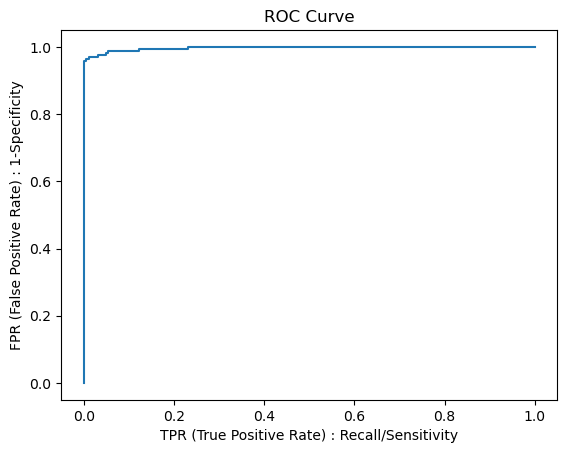

In [49]:
plt.plot(tpr,fpr)
plt.xlabel("TPR (True Positive Rate) : Recall/Sensitivity")
plt.ylabel("FPR (False Positive Rate) : 1-Specificity")
plt.title("ROC Curve")

# RANDOM FOREST

## Model Training

In [51]:
rf_clf = RandomForestClassifier()
rf_clf

RandomForestClassifier()

In [52]:
rf_clf_model = rf_clf.fit(xtrain,ytrain)
rf_clf_model

RandomForestClassifier()

## Model Evalution

In [53]:
ytrain_pred = rf_clf_model.predict(xtrain)

In [54]:
#training

print(accuracy_score(ytrain,ytrain_pred))
print("-"*60)
print(classification_report(ytrain,ytrain_pred))
print("-"*60)
print(confusion_matrix(ytrain,ytrain_pred))

1.0
------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       170
           1       1.00      1.00      1.00       285

    accuracy                           1.00       455
   macro avg       1.00      1.00      1.00       455
weighted avg       1.00      1.00      1.00       455

------------------------------------------------------------
[[170   0]
 [  0 285]]


In [55]:

ytest_pred = rf_clf_model.predict(xtest)

In [56]:
#testing

print(accuracy_score(ytest,ytest_pred))
print("-"*60)
print(classification_report(ytest,ytest_pred))
print("-"*60)
print(confusion_matrix(ytest,ytest_pred))

0.9473684210526315
------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.90      0.93        42
           1       0.95      0.97      0.96        72

    accuracy                           0.95       114
   macro avg       0.95      0.94      0.94       114
weighted avg       0.95      0.95      0.95       114

------------------------------------------------------------
[[38  4]
 [ 2 70]]


## Feature Selection

In [57]:
rf_clf_model.feature_importances_

array([0.02570203, 0.00926365, 0.02777794, 0.10246362, 0.14463923,
       0.00583339, 0.0169382 , 0.06801736, 0.00840957, 0.0315486 ,
       0.11659575, 0.01444243, 0.00939315, 0.02346449, 0.0142615 ,
       0.01139429, 0.01158762, 0.02244983, 0.01596979, 0.02703775,
       0.08286314, 0.1880761 , 0.01377463, 0.00809595])

In [58]:
s1 = pd.Series(rf_clf_model.feature_importances_, index= x.columns)
s1

mean texture               0.025702
mean smoothness            0.009264
mean compactness           0.027778
mean concavity             0.102464
mean concave points        0.144639
mean symmetry              0.005833
mean fractal dimension     0.016938
radius error               0.068017
texture error              0.008410
perimeter error            0.031549
area error                 0.116596
smoothness error           0.014442
compactness error          0.009393
concavity error            0.023464
concave points error       0.014262
symmetry error             0.011394
fractal dimension error    0.011588
worst texture              0.022450
worst smoothness           0.015970
worst compactness          0.027038
worst concavity            0.082863
worst concave points       0.188076
worst symmetry             0.013775
worst fractal dimension    0.008096
dtype: float64

<Axes: >

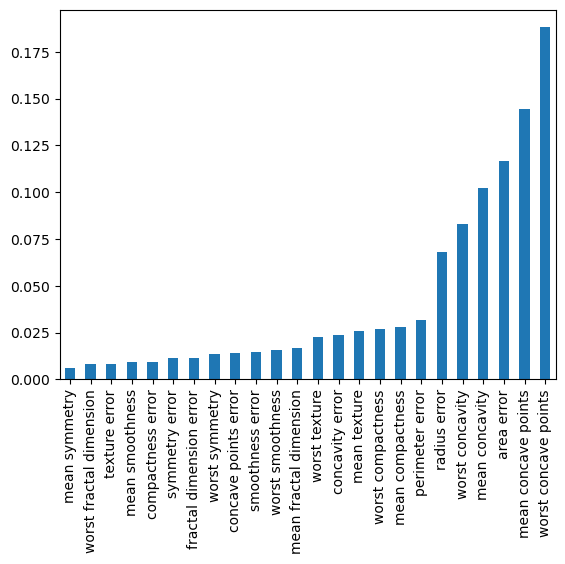

In [59]:
s1.sort_values().plot(kind = "bar")

## hyperparameter tunning

In [60]:
hyperparameters = {
    "criterion" : ["entropy","gini"],
    "max_depth" : np.arange(2,10),
    "min_samples_split" : np.arange(2,20),
    "min_samples_leaf" : np.arange(2,20),
    "n_estimators" : np.arange(10,100),
    "max_features" : ["auto"]
}

In [82]:
rf_clf_hyp = RandomizedSearchCV(rf_clf_model,hyperparameters,cv=5)
rf_clf_hyp_model = rf_clf_hyp.fit(xtrain,ytrain)
rf_clf_hyp_model

RandomizedSearchCV(cv=5, estimator=RandomForestClassifier(),
                   param_distributions={'criterion': ['entropy', 'gini'],
                                        'max_depth': array([2, 3, 4, 5, 6, 7, 8, 9]),
                                        'max_features': ['auto'],
                                        'min_samples_leaf': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
       19]),
                                        'min_samples_split': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
       19]),
                                        'n_estimators': array([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
       27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43,
       44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60,
       61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77,
       78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94,
       95, 96, 97, 98, 99])})

In [62]:
rf_clf_hyp_model.best_estimator_

RandomForestClassifier(criterion='entropy', max_depth=7, max_features='auto',
                       min_samples_leaf=3, min_samples_split=5,
                       n_estimators=32)

In [83]:
rf_clf_hyp_model = RandomForestClassifier(max_depth=6, max_features='auto', min_samples_leaf=2,
                       min_samples_split=11, n_estimators=81)

rf_clf_hyp_model.fit(xtrain,ytrain)

RandomForestClassifier(max_depth=6, max_features='auto', min_samples_leaf=2,
                       min_samples_split=11, n_estimators=81)

## Model Evaluation

In [64]:
ytrain_pred = rf_clf_hyp_model.predict(xtrain)

In [65]:
#training

print(accuracy_score(ytrain,ytrain_pred))
print("-"*60)
print(classification_report(ytrain,ytrain_pred))
print("-"*60)
print(confusion_matrix(ytrain,ytrain_pred))

0.9802197802197802
------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.99      0.96      0.97       170
           1       0.98      0.99      0.98       285

    accuracy                           0.98       455
   macro avg       0.98      0.98      0.98       455
weighted avg       0.98      0.98      0.98       455

------------------------------------------------------------
[[163   7]
 [  2 283]]


In [66]:
ytest_pred = rf_clf_hyp_model.predict(xtest)

In [67]:
#testing

print(accuracy_score(ytest,ytest_pred))
print("-"*60)
print(classification_report(ytest,ytest_pred))
print("-"*60)
print(confusion_matrix(ytest,ytest_pred))

0.9473684210526315
------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.90      0.93        42
           1       0.95      0.97      0.96        72

    accuracy                           0.95       114
   macro avg       0.95      0.94      0.94       114
weighted avg       0.95      0.95      0.95       114

------------------------------------------------------------
[[38  4]
 [ 2 70]]


# ADABOOST

## Model Training

In [71]:
ab_clf = AdaBoostClassifier()
ab_clf_model = ab_clf.fit(xtrain,ytrain)
ab_clf_model

AdaBoostClassifier()

In [72]:
ytrain_pred  = ab_clf_model.predict(xtrain)

## Model Evaluation

1.0
------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       170
           1       1.00      1.00      1.00       285

    accuracy                           1.00       455
   macro avg       1.00      1.00      1.00       455
weighted avg       1.00      1.00      1.00       455

------------------------------------------------------------


<Axes: >

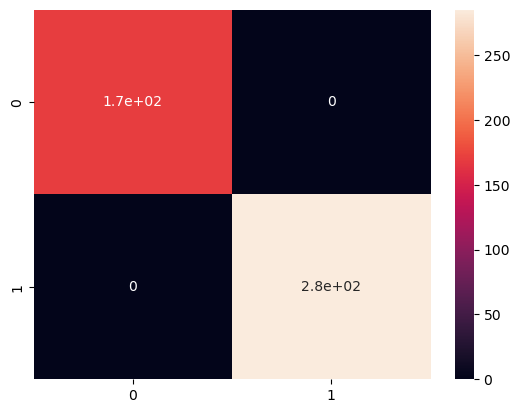

In [73]:
#training

print(accuracy_score(ytrain,ytrain_pred))
print("-"*60)
print(classification_report(ytrain,ytrain_pred))
print("-"*60)
sns.heatmap(confusion_matrix(ytrain,ytrain_pred),annot=True)

In [74]:
ytest_pred = ab_clf_model.predict(xtest)

0.9824561403508771
------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.98      0.98      0.98        42
           1       0.99      0.99      0.99        72

    accuracy                           0.98       114
   macro avg       0.98      0.98      0.98       114
weighted avg       0.98      0.98      0.98       114

------------------------------------------------------------


<Axes: >

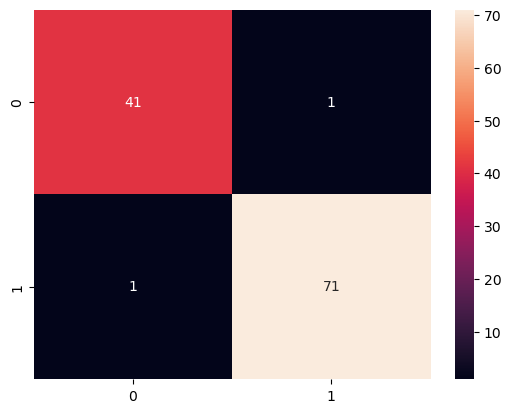

In [75]:
#testing

print(accuracy_score(ytest,ytest_pred))
print("-"*60)
print(classification_report(ytest,ytest_pred))
print("-"*60)
sns.heatmap(confusion_matrix(ytest,ytest_pred),annot=True)

## Embedded Feature Selection

In [76]:
ab_clf_model.feature_importances_

array([0.06, 0.  , 0.02, 0.  , 0.08, 0.02, 0.02, 0.02, 0.04, 0.02, 0.18,
       0.02, 0.06, 0.  , 0.02, 0.02, 0.04, 0.1 , 0.06, 0.  , 0.04, 0.12,
       0.04, 0.02])

In [77]:
s1 = pd.Series(ab_clf_model.feature_importances_,index = x.columns)
s1

mean texture               0.06
mean smoothness            0.00
mean compactness           0.02
mean concavity             0.00
mean concave points        0.08
mean symmetry              0.02
mean fractal dimension     0.02
radius error               0.02
texture error              0.04
perimeter error            0.02
area error                 0.18
smoothness error           0.02
compactness error          0.06
concavity error            0.00
concave points error       0.02
symmetry error             0.02
fractal dimension error    0.04
worst texture              0.10
worst smoothness           0.06
worst compactness          0.00
worst concavity            0.04
worst concave points       0.12
worst symmetry             0.04
worst fractal dimension    0.02
dtype: float64

<Axes: >

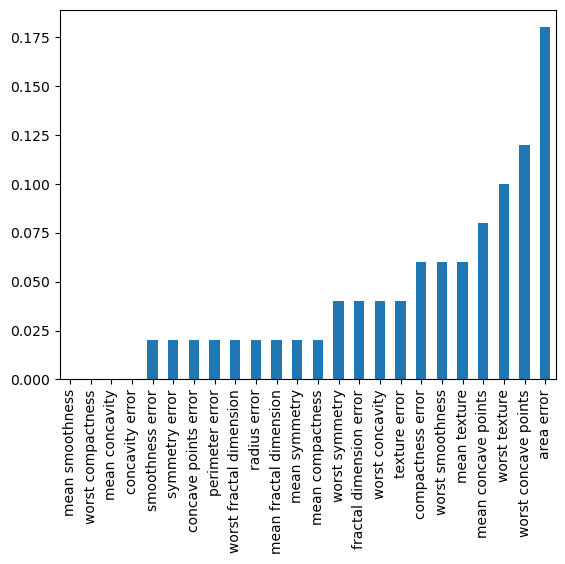

In [78]:
s1.sort_values().plot(kind = "bar")

## Hyperparameter Tunning

In [79]:
hyp = {
    "n_estimators" : np.arange(10,50),
    "learning_rate" : np.array([0,0.1,0.01,0.0001,1])
}

In [84]:
ab_rscv_hyp = RandomizedSearchCV(ab_clf_model,hyp,cv= 5)
ab_rscv_hyp.fit(xtrain,ytrain)
ab_rscv_hyp.best_estimator_

AdaBoostClassifier(n_estimators=33)

In [85]:
ab_rscv_hyp = AdaBoostClassifier(n_estimators=18)
ab_rscv_hyp_model = ab_rscv_hyp.fit(xtrain,ytrain)

In [86]:
ytrain_pred = ab_rscv_hyp_model.predict(xtrain)

0.9912087912087912
------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.99      0.99      0.99       170
           1       0.99      0.99      0.99       285

    accuracy                           0.99       455
   macro avg       0.99      0.99      0.99       455
weighted avg       0.99      0.99      0.99       455

------------------------------------------------------------


<Axes: >

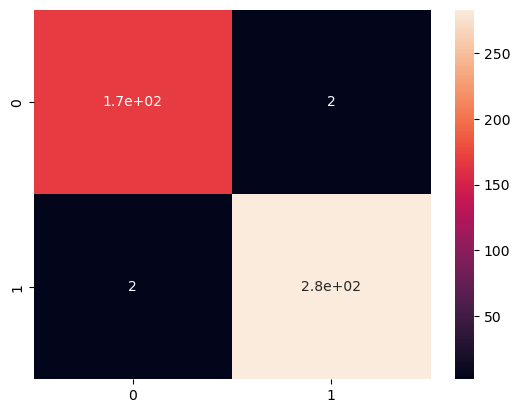

In [87]:
#training

print(accuracy_score(ytrain,ytrain_pred))
print("-"*60)
print(classification_report(ytrain,ytrain_pred))
print("-"*60)
sns.heatmap(confusion_matrix(ytrain,ytrain_pred),annot=True)

In [88]:
ytest_pred  = ab_rscv_hyp_model.predict(xtest)

0.9649122807017544
------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.98      0.95        42
           1       0.99      0.96      0.97        72

    accuracy                           0.96       114
   macro avg       0.96      0.97      0.96       114
weighted avg       0.97      0.96      0.97       114

------------------------------------------------------------


<Axes: >

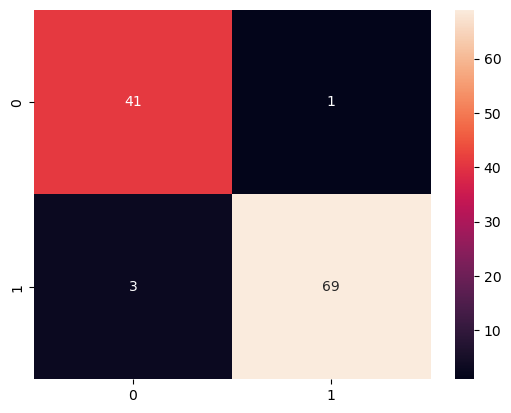

In [89]:
#testing

print(accuracy_score(ytest,ytest_pred))
print("-"*60)
print(classification_report(ytest,ytest_pred))
print("-"*60)
sns.heatmap(confusion_matrix(ytest,ytest_pred),annot=True)

# DECISION TREE

## Model Training

In [117]:
dt_clf = DecisionTreeClassifier()
dt_clf

DecisionTreeClassifier()

In [118]:
dt_clf_model = dt_clf.fit(xtrain,ytrain)
dt_clf_model

DecisionTreeClassifier()

## Model Evaluation

In [119]:
ypred_train = dt_clf_model.predict(xtrain)
ypred_train

array([1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0,
       1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1,
       0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0,
       1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0,
       1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1,
       1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1,
       1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1,
       0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1,

Accuracy : 1.0
************************************************************
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       170
           1       1.00      1.00      1.00       285

    accuracy                           1.00       455
   macro avg       1.00      1.00      1.00       455
weighted avg       1.00      1.00      1.00       455



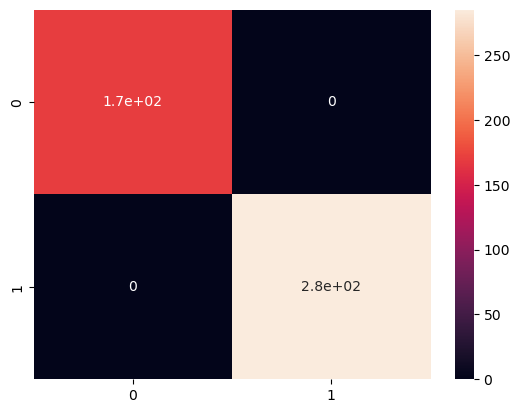

In [120]:
#training

acc = accuracy_score(ytrain,ypred_train)
print(f"Accuracy : {acc}") #overfitting
print("*"*60)

conf_mat = confusion_matrix(ytrain,ypred_train)
sns.heatmap(conf_mat, annot=True)

print(classification_report(ytrain,ypred_train))

In [121]:
ytest_pred = dt_clf_model.predict(xtest)

Accuracy : 0.9210526315789473
************************************************************
              precision    recall  f1-score   support

           0       0.87      0.93      0.90        42
           1       0.96      0.92      0.94        72

    accuracy                           0.92       114
   macro avg       0.91      0.92      0.92       114
weighted avg       0.92      0.92      0.92       114



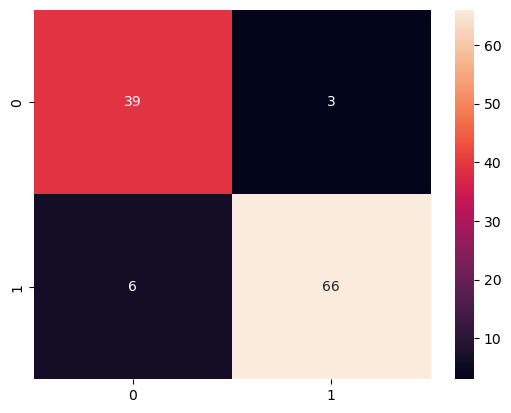

In [122]:
#testing

acc = accuracy_score(ytest,ytest_pred)
print(f"Accuracy : {acc}") #overfitting
print("*"*60)

conf_mat = confusion_matrix(ytest,ytest_pred)
sns.heatmap(conf_mat, annot=True)

print(classification_report(ytest,ytest_pred))

In [123]:
plt.figure(figsize=(100,100))
plot_tree(dt_clf, feature_names=df.columns, class_names={0:"NO",1:"Yes"},filled=True)
plt.savefig("DecisionTree")

## Hyperparameter Tunning

In [124]:
hyperparameters = {
    "criterion" : ["entropy","gini"],
    "max_depth" : np.arange(3,10),
    "min_samples_split" : np.arange(2,20),
    "min_samples_leaf" : np.arange(2,20)    
}

In [125]:
gscv = GridSearchCV(dt_clf, hyperparameters, cv = 5)
gscv

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['entropy', 'gini'],
                         'max_depth': array([3, 4, 5, 6, 7, 8, 9]),
                         'min_samples_leaf': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
       19]),
                         'min_samples_split': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
       19])})

In [129]:
gscv.fit(xtrain,ytrain)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['entropy', 'gini'],
                         'max_depth': array([3, 4, 5, 6, 7, 8, 9]),
                         'min_samples_leaf': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
       19]),
                         'min_samples_split': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
       19])})

In [130]:
gscv.best_estimator_

DecisionTreeClassifier(criterion='entropy', max_depth=4, min_samples_leaf=2,
                       min_samples_split=8)

In [131]:
dt_clf_hyp = DecisionTreeClassifier(max_depth=5, min_samples_leaf=3, min_samples_split=11)

In [132]:
dt_clf_hyp.fit(xtrain,ytrain)

DecisionTreeClassifier(max_depth=5, min_samples_leaf=3, min_samples_split=11)

## Evaluation

In [133]:
ypred_train = dt_clf_hyp.predict(xtrain)
ypred_train

array([1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0,
       1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1,
       0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0,
       1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1,
       1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0,
       1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1,
       1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1,
       1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1,
       0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1,

Accuracy : 0.9714285714285714
************************************************************
              precision    recall  f1-score   support

           0       0.96      0.96      0.96       170
           1       0.98      0.98      0.98       285

    accuracy                           0.97       455
   macro avg       0.97      0.97      0.97       455
weighted avg       0.97      0.97      0.97       455



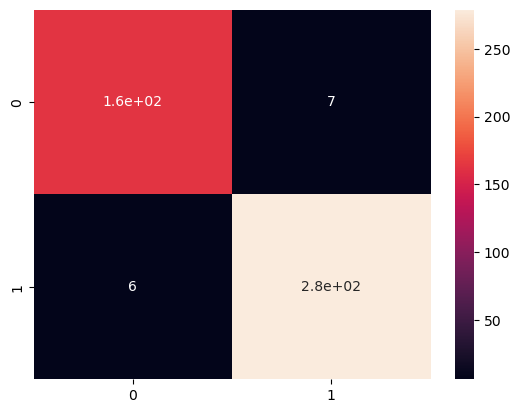

In [134]:
# training data

acc = accuracy_score(ytrain,ypred_train)
print(f"Accuracy : {acc}") #overfitting
print("*"*60)

conf_mat = confusion_matrix(ytrain,ypred_train)
sns.heatmap(conf_mat, annot=True)

print(classification_report(ytrain,ypred_train))

In [135]:
ytest_pred = dt_clf_hyp.predict(xtest)

Accuracy : 0.9298245614035088
************************************************************
              precision    recall  f1-score   support

           0       0.89      0.93      0.91        42
           1       0.96      0.93      0.94        72

    accuracy                           0.93       114
   macro avg       0.92      0.93      0.93       114
weighted avg       0.93      0.93      0.93       114



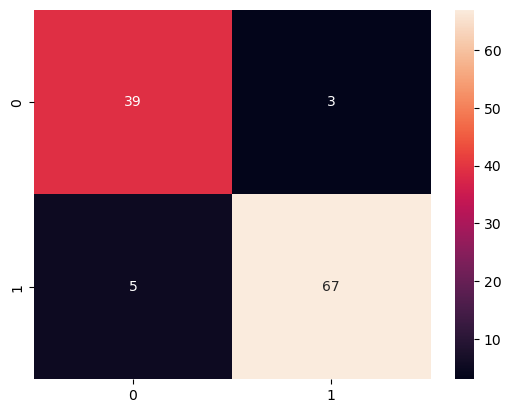

In [136]:
# testing data

acc = accuracy_score(ytest,ytest_pred)
print(f"Accuracy : {acc}") #overfitting
print("*"*60)

conf_mat = confusion_matrix(ytest,ytest_pred)
sns.heatmap(conf_mat, annot=True)

print(classification_report(ytest,ytest_pred))

In [137]:
plt.figure(figsize=(100,100))
plot_tree(dt_clf_hyp, feature_names=df.columns, class_names={0:"NO",1:"Yes"},filled=True)
plt.savefig("DecisionTreehyp")

## Feature Selection : Embedded Method (After Model Training)

In [138]:
dt_clf_model.feature_importances_

array([0.02390468, 0.00704334, 0.01609907, 0.0111127 , 0.        ,
       0.        , 0.        , 0.02453222, 0.        , 0.        ,
       0.13956527, 0.01200789, 0.01460842, 0.        , 0.        ,
       0.        , 0.00932356, 0.00935356, 0.01408669, 0.00866873,
       0.        , 0.69912885, 0.01056502, 0.        ])

In [139]:
s1 = pd.Series(dt_clf_model.feature_importances_,index = x.columns)
s1

mean texture               0.023905
mean smoothness            0.007043
mean compactness           0.016099
mean concavity             0.011113
mean concave points        0.000000
mean symmetry              0.000000
mean fractal dimension     0.000000
radius error               0.024532
texture error              0.000000
perimeter error            0.000000
area error                 0.139565
smoothness error           0.012008
compactness error          0.014608
concavity error            0.000000
concave points error       0.000000
symmetry error             0.000000
fractal dimension error    0.009324
worst texture              0.009354
worst smoothness           0.014087
worst compactness          0.008669
worst concavity            0.000000
worst concave points       0.699129
worst symmetry             0.010565
worst fractal dimension    0.000000
dtype: float64

<Axes: >

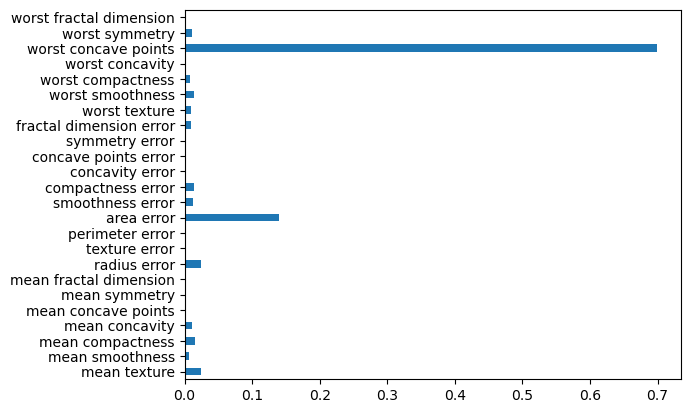

In [140]:
s1.plot(kind="barh")

In [141]:
dt_clf_hyp.feature_importances_

array([0.02610472, 0.        , 0.0026296 , 0.01213545, 0.        ,
       0.        , 0.        , 0.02679001, 0.        , 0.        ,
       0.15241002, 0.01311303, 0.        , 0.0033447 , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.76347248, 0.        , 0.        ])

<Axes: >

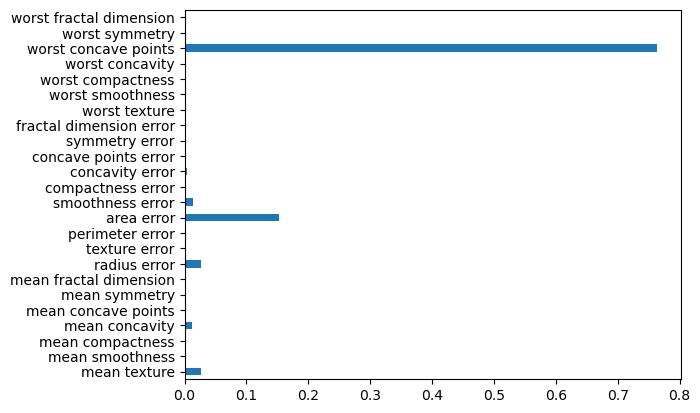

In [142]:
s1 = pd.Series(dt_clf_hyp.feature_importances_,index=x.columns)
s1.plot(kind="barh")

## Model Save into pickle file

In [143]:
import pickle

In [144]:
with open("DT_model.pkl","wb") as f:
    pickle.dump(dt_clf_model,f)

In [145]:
data = x.head(1)
data

,mean texture,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,...,concave points error,symmetry error,fractal dimension error,worst texture,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,-2.073335,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747,2.489734,-0.565265,2.833031,...,0.66082,1.148757,0.907083,-1.359293,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015


In [153]:
class ClassPrediction():
    def Prediction(self,data):
        with open("DT_model.pkl","rb") as f:
            model = pickle.load(f)
    
        pred = model.predict(data)[0]
        
        if pred == 0:
            print("Patient does not having Breast_Cancer")
        else:
            print("Patient having Breast_Cancer!!")

In [154]:
cancer = ClassPrediction()

In [155]:
cancer.Prediction(data)

Patient does not having Breast_Cancer


# SVM

## Model Training

In [157]:
svc = SVC()
svc.fit(xtrain,ytrain)

SVC()

## Model Evaluation

In [161]:
ytrain_pred = svc.predict(xtrain)

0.978021978021978
************************************************************
              precision    recall  f1-score   support

           0       1.00      0.94      0.97       170
           1       0.97      1.00      0.98       285

    accuracy                           0.98       455
   macro avg       0.98      0.97      0.98       455
weighted avg       0.98      0.98      0.98       455



<Axes: >

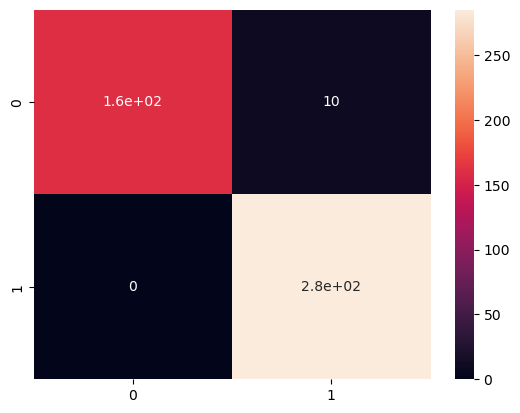

In [159]:
print(accuracy_score(ytrain,ytrain_pred))
print("*"*60)
print(classification_report(ytrain,ytrain_pred))
sns.heatmap(confusion_matrix(ytrain,ytrain_pred), annot=True)

In [160]:
ytest_pred = svc.predict(xtest)

0.9649122807017544
************************************************************
              precision    recall  f1-score   support

           0       0.97      0.93      0.95        42
           1       0.96      0.99      0.97        72

    accuracy                           0.96       114
   macro avg       0.97      0.96      0.96       114
weighted avg       0.97      0.96      0.96       114



<Axes: >

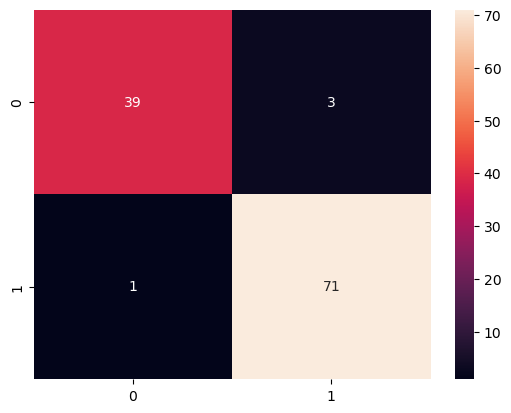

In [162]:
print(accuracy_score(ytest,ytest_pred))
print("*"*60)
print(classification_report(ytest,ytest_pred))
sns.heatmap(confusion_matrix(ytest,ytest_pred), annot=True)

In [163]:
macro_avg = (0.97+0.96)/2 # macro_avg = (precision(class0) + precision(class1))/2
macro_avg

0.965

## Hyperparameter Tunning

In [164]:
hyp = {
    "kernel" : ["linear","rbf"],
    "C" : np.arange(1,20)
}

In [165]:
gscv = GridSearchCV(svc, hyp, cv = 4)
gscv.fit(xtrain,ytrain)

GridSearchCV(cv=4, estimator=SVC(),
             param_grid={'C': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19]),
                         'kernel': ['linear', 'rbf']})

In [166]:
gscv.best_estimator_

SVC(C=4)

In [167]:
svc = SVC(C=1)
svc.fit(xtrain,ytrain)

SVC(C=1)

In [168]:
ytrain_predict = svc.predict(xtrain)

0.978021978021978
************************************************************
              precision    recall  f1-score   support

           0       1.00      0.94      0.97       170
           1       0.97      1.00      0.98       285

    accuracy                           0.98       455
   macro avg       0.98      0.97      0.98       455
weighted avg       0.98      0.98      0.98       455



<Axes: >

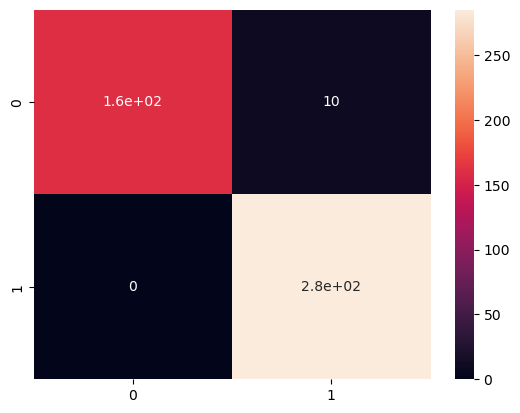

In [169]:
print(accuracy_score(ytrain,ytrain_pred))
print("*"*60)
print(classification_report(ytrain,ytrain_pred))
sns.heatmap(confusion_matrix(ytrain,ytrain_pred), annot=True)

In [170]:
y7test_pred = svc.predict(xtest)

0.9649122807017544
************************************************************
              precision    recall  f1-score   support

           0       0.97      0.93      0.95        42
           1       0.96      0.99      0.97        72

    accuracy                           0.96       114
   macro avg       0.97      0.96      0.96       114
weighted avg       0.97      0.96      0.96       114



<Axes: >

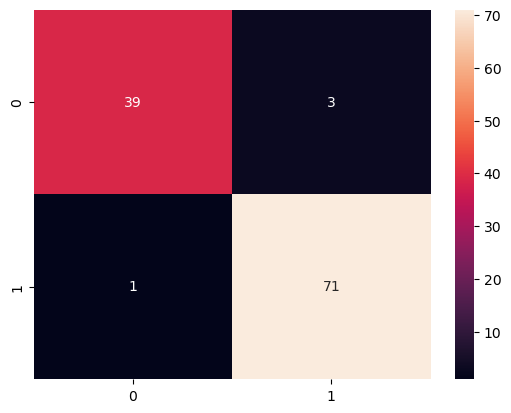

In [171]:
print(accuracy_score(ytest,ytest_pred))
print("*"*60)
print(classification_report(ytest,ytest_pred))
sns.heatmap(confusion_matrix(ytest,ytest_pred), annot=True)